# Twitter Network Analysis for Nike, Lululemon & Adidas Brands

# Project Overview

The aim of this project is to use a curated data set concerning tweets about Nike, Lululemon and Adidas to construct social networks and semantic networks around these brands.

The social network concerns relationships between twitter users through mentions, whereas the semantic network considers what words in tweets are highly associated with the brands based on co-occurences of words in tweets.

The outline and code for this notebook borrows heavily from Dr. Vargo's work found in the following notebooks below:  

MSDS Network Analysis, Lab 1: Build a Mentions Network, 
https://colab.research.google.com/drive/1Wj_hwlY2n4YyXp2r4Q0vgXG9RHaUJ7RJ

MSDS Network Analysis, Lab 2: Build a Semantic Network
https://colab.research.google.com/drive/1okswykRNiEs118yKTzcLO0eaSGVwMQRa

# Imports

In [ ]:
import json
import networkx as nx
import matplotlib.pyplot as plt
import nltk
import string
import random 
import numpy as np
import itertools
nltk.download("punkt")
nltk.download("stopwords")
nltk.download("wordnet")
nltk.download('omw-1.4')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to /root/nltk_data...
[nltk_data]   Package omw-1.4 is already up-to-date!


True

# Downloading Data

This notebook is self-contained and data is downloaded from an external source for analysis.

In [ ]:
!wget http://128.138.93.164/nikelululemonadidas_tweets.jsonl.gz -P /content/drive/MyDrive/MSDS_marketing_text_analytics/master_files/3_network_analysis
!gzip -d /content/drive/MyDrive/MSDS_marketing_text_analytics/master_files/3_network_analysis/nikelululemonadidas_tweets.jsonl.gz

--2022-08-15 17:03:44--  http://128.138.93.164/nikelululemonadidas_tweets.jsonl.gz
Connecting to 128.138.93.164:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 101247175 (97M) [application/octet-stream]
Saving to: ‘/content/drive/MyDrive/MSDS_marketing_text_analytics/master_files/3_network_analysis/nikelululemonadidas_tweets.jsonl.gz.1’

nikelululemonadidas 100%[===================>]  96.56M  52.1MB/s    in 1.9s    

2022-08-15 17:03:46 (52.1 MB/s) - ‘/content/drive/MyDrive/MSDS_marketing_text_analytics/master_files/3_network_analysis/nikelululemonadidas_tweets.jsonl.gz.1’ saved [101247175/101247175]

gzip: /content/drive/MyDrive/MSDS_marketing_text_analytics/master_files/3_network_analysis/nikelululemonadidas_tweets.jsonl already exists; do you wish to overwrite (y or n)? ^C


In [ ]:
WORKING_DIR = "/content/drive/MyDrive/MSDS_marketing_text_analytics/master_files/3_network_analysis"

# Data Preprocessing

In [ ]:
json_file = open('%s/nikelululemonadidas_tweets.jsonl' % WORKING_DIR, 'r')

In [ ]:
# Identify unique users in the twitter data
uniqueusers = {}

# Identify non-tweeters who may be influential
potential_non_tweeters = []

for i, line in enumerate(json_file):
  if i % 10000 == 0: # Shows updates
    print("%s tweets processed" % i)
  tweet = json.loads(line)
  user = tweet["user"]
  user_sn = user["screen_name"] # Allows searching for strings
  if user_sn not in uniqueusers:
    uniqueusers[user_sn] = {
                "id": user["id"],
                "tweet_count": 0,
                "followers_count": user["followers_count"]
                 }
  uniqueusers[user_sn]["tweet_count"] += 1
  # Below helps later check users who are tweeted at but may not tweet
  users_mentioned = tweet["entities"]["user_mentions"]
  if len(users_mentioned) > 0:
    for auser in users_mentioned:
      user_sn = auser["screen_name"]
      potential_non_tweeters.append(user_sn)

print(f"{i} total Tweets processed")

0 tweets processed
10000 tweets processed
20000 tweets processed
30000 tweets processed
40000 tweets processed
50000 tweets processed
60000 tweets processed
70000 tweets processed
80000 tweets processed
90000 tweets processed
100000 tweets processed
110000 tweets processed
120000 tweets processed
130000 tweets processed
140000 tweets processed
150000 tweets processed
160000 tweets processed
170000 tweets processed
175077 total Tweets processed


In [ ]:
len(uniqueusers)

104772

In [ ]:
non_tweeters = {}

for screen_name in potential_non_tweeters:
    if screen_name not in uniqueusers:
      if screen_name not in non_tweeters:
        non_tweeters[screen_name] = {
                    "id": user['id'],
                    "mention_count": 0
                    }
      non_tweeters[screen_name]["mention_count"] += 1

In [ ]:
len(non_tweeters)

26901

The number of unique users - both those who tweeted and those who were only mentioned, is substantial and needs to be pruned for any meaningful network analysis.

In [ ]:
userstoinclude = set() # Set guarantees uniqueness

min_follower_count = 2000000 # Those with 2000000 or more followers are influential

for auser in uniqueusers: 
  if uniqueusers[auser]["followers_count"] > min_follower_count: 
    userstoinclude.add(auser)
print(len(userstoinclude))

40



On a first pass, in order to have a comprehensible understanding of the social network structure, the number of nodes is reduced by considering only those who tweeted who have at least 2 million followers which results in 40 unique users to consider. These can be considered influencers for the space that this data set is constructed around  as this is an atypically high follower count. 

Additional passes at different thresholds of minimum follower count can be coducted for further insights.

However, whatever level of followers are set, the ensuing set of nodes does not capture Nike or Lululemon as they have not tweeted. So in addition to those who have tweeted with high follower count, those who are mentioned more than 1000 times who have not tweeted are also considered as part of our network. 1000 mentions is also atypically high and suggests a high level of sought engagement and thus influence.


In [ ]:
for auser in non_tweeters:
  if non_tweeters[auser]["mention_count"] > 1000:
      print(auser)
      userstoinclude.add(auser)
print(len(userstoinclude))

footlocker
Nike
LaserShip
SneakerAdmirals
amazon
lululemon
AustinEkeler
RonWyden
RTFKTstudios
BoredApeYC
50


10 additional twitter accounts are captured using a mention counts threshold of 1000 for those who don't tweet, including both "Nike" and "lululemon" resulting in 50 nodes in total. Some other interesting accounts are also captured with this filter.

# Social Network, 50 Influencers


The networkx package is used for constructing graphs. Here a directed graph is used as mentions are not symmetric - one user is mentioning another in a tweet.

In [ ]:
Graph = nx.DiGraph()

A network graph is constructed with directed edges based on if one of the fifty twitter accounts mentions another one of those fifty accounts.

In [ ]:
json_file = open('%s/nikelululemonadidas_tweets.jsonl' % WORKING_DIR, 'r')

In [ ]:
for i, line in enumerate(json_file):
  if i % 10000 == 0:
    print("%s tweets processed" % i)
  tweet = json.loads(line)
  sender_name = tweet["user"]["screen_name"]
  if sender_name in userstoinclude:
    for mention in tweet["entities"]["user_mentions"]:
      receiver_name = mention["screen_name"]
      if receiver_name in userstoinclude:
        Graph.add_edge(sender_name, receiver_name)

print(f"{i} total Tweets processed")

0 tweets processed
10000 tweets processed
20000 tweets processed
30000 tweets processed
40000 tweets processed
50000 tweets processed
60000 tweets processed
70000 tweets processed
80000 tweets processed
90000 tweets processed
100000 tweets processed
110000 tweets processed
120000 tweets processed
130000 tweets processed
140000 tweets processed
150000 tweets processed
160000 tweets processed
170000 tweets processed
175077 total Tweets processed


In [ ]:
nx.info(Graph)

'DiGraph with 45 nodes and 63 edges'

The resulting graph has 45 twitter accounts as nodes and 63 directed edges meaning 63 times one of those 45 accounts mentioned another of those 45 accounts.

Self-loop edges (which represent self-mentions) are removed as they are not informative for our analysis. This results in five additional edges being removed.

In [ ]:
Graph.remove_edges_from(nx.selfloop_edges(Graph))
nx.info(Graph)

'DiGraph with 45 nodes and 58 edges'

In [ ]:
random.seed(0) # for reproducibility
np.random.seed(0) # for reproducibility
fig, ax = plt.subplots(1, 1, figsize=(200, 200))
#ugh these settings are such a pain, but here's the way to look them up: 
#https://networkx.org/documentation/stable/reference/generated/networkx.drawing.nx_pylab.draw_networkx.html
nx.draw_networkx(Graph, ax=ax, font_color="#FFFFFF", font_size=20, node_size=30000, width=4, arrowsize=100)
plt.savefig("%s/mention_network.png" % WORKING_DIR, format="PNG")

In [ ]:
Graph.edges

OutEdgeView([('ArchDigest', 'KingJames'), ('ArchDigest', 'Nike'), ('KingJames', 'Nike'), ('nikestore', 'Nike'), ('nikestore', 'Roblox'), ('nikestore', 'Jumpman23'), ('nikestore', 'SneakerAdmirals'), ('wwd', 'Nike'), ('wwd', 'adidas'), ('wwd', 'lululemon'), ('DashieXP', 'Xbox'), ('DashieXP', 'adidas'), ('Xbox', 'adidas'), ('Xbox', 'adidasoriginals'), ('adidas', 'Xbox'), ('adidas', 'Nike'), ('adidasoriginals', 'adidas'), ('FastCompany', 'Nike'), ('Complex', 'adidas'), ('dallascowboys', 'Nike'), ('Jumpman23', 'Nike'), ('LFC', 'Nike'), ('LFC', 'KingJames'), ('nikebasketball', 'Nike'), ('nikebasketball', 'Giannis_An34'), ('nikebasketball', 'nikestore'), ('tarajiphenson', 'Nike'), ('marcorubio', 'Nike'), ('MissyElliott', 'adidas'), ('MissyElliott', 'adidasoriginals'), ('DonaldJTrumpJr', 'Nike'), ('DonaldJTrumpJr', 'RonWyden'), ('jaketapper', 'Nike'), ('QuavoStuntin', 'adidas'), ('BusinessInsider', 'Nike'), ('CoinDesk', 'Nike'), ('CoinDesk', 'adidas'), ('CoinDesk', 'RTFKTstudios'), ('adidasfo

In [ ]:
brand_counts = {}
brand_counts['lululemon'] = 0 
brand_counts['Nike'] = 0
brand_counts['adidas'] = 0

for edge in Graph.edges:
 for node in edge:
   if node in brand_counts:
     brand_counts[node] += 1

brand_counts

{'Nike': 24, 'adidas': 14, 'lululemon': 3}

 Of the 58 edges, 24 are associated with the twitter account for Nike and 14 for Adidas suggesting they are very central to the network. On the other hand, Lululemon is on the periphery on the network with only 3 edges. "adidasoriginals" and "adidasfootball" are related accounts of adidas and for Nike there is "nikestore" and "nikebasketball".


# Social Network, 100 Influencers

Setting the threshold to a million followers results in 90 accounts and in addition to the 10 non-tweeting highly mentioned accounts, results in 100 influences in total. The code blocks below follow the same procedure and the slightly expanded network is analyzed and both networks considered for marketing analytics insights.

In [ ]:
userstoinclude_large = set() 

min_follower_count = 1000000

for auser in uniqueusers: 
  if uniqueusers[auser]["followers_count"] > min_follower_count: 
    userstoinclude_large.add(auser)
print(len(userstoinclude_large))

90


In [ ]:
for auser in non_tweeters:
  if non_tweeters[auser]["mention_count"] > 1000:
      print(auser)
      userstoinclude_large.add(auser)
print(len(userstoinclude_large))

footlocker
Nike
LaserShip
SneakerAdmirals
amazon
lululemon
AustinEkeler
RonWyden
RTFKTstudios
BoredApeYC
100


In [ ]:
json_file = open('%s/nikelululemonadidas_tweets.jsonl' % WORKING_DIR, 'r')

In [ ]:
Graph = nx.DiGraph()

In [ ]:
for i, line in enumerate(json_file):
  if i % 10000 == 0:
    print("%s tweets processed" % i)
  tweet = json.loads(line)
  sender_name = tweet["user"]["screen_name"]
  if sender_name in userstoinclude_large:
    for mention in tweet["entities"]["user_mentions"]:
      receiver_name = mention["screen_name"]
      if receiver_name in userstoinclude_large:
        Graph.add_edge(sender_name, receiver_name)

print(f"{i} total Tweets processed")

0 tweets processed
10000 tweets processed
20000 tweets processed
30000 tweets processed
40000 tweets processed
50000 tweets processed
60000 tweets processed
70000 tweets processed
80000 tweets processed
90000 tweets processed
100000 tweets processed
110000 tweets processed
120000 tweets processed
130000 tweets processed
140000 tweets processed
150000 tweets processed
160000 tweets processed
170000 tweets processed
175077 total Tweets processed


In [ ]:
nx.info(Graph)

'DiGraph with 95 nodes and 142 edges'

In [ ]:
Graph.remove_edges_from(nx.selfloop_edges(Graph))
nx.info(Graph)

'DiGraph with 95 nodes and 131 edges'

In [ ]:
random.seed(0) # for reproducibility
np.random.seed(0) # for reproducibility
fig, ax = plt.subplots(1, 1, figsize=(300, 300))
#ugh these settings are such a pain, but here's the way to look them up: 
#https://networkx.org/documentation/stable/reference/generated/networkx.drawing.nx_pylab.draw_networkx.html
nx.draw_networkx(Graph, ax=ax, font_color="#FFFFFF", font_size=20, node_size=30000, width=4, arrowsize=100)
plt.savefig("%s/mention_network2.png" % WORKING_DIR, format="PNG")

In [ ]:
Graph.edges

OutEdgeView([('ArchDigest', 'KingJames'), ('ArchDigest', 'Nike'), ('KingJames', 'Nike'), ('nikestore', 'Nike'), ('nikestore', 'Roblox'), ('nikestore', 'Jumpman23'), ('nikestore', 'SneakerAdmirals'), ('jermainedupri', 'adidas'), ('jermainedupri', 'ATLHawks'), ('adidas', 'BurgerKing'), ('adidas', 'Xbox'), ('adidas', 'Nike'), ('wwd', 'Nike'), ('wwd', 'adidas'), ('wwd', 'lululemon'), ('LAKings', 'adidas'), ('DashieXP', 'Xbox'), ('DashieXP', 'adidas'), ('Xbox', 'adidas'), ('Xbox', 'adidasoriginals'), ('adidasoriginals', 'adidas'), ('FastCompany', 'Nike'), ('dezeen', 'Nike'), ('dezeen', 'adidas'), ('dezeen', 'BoredApeYC'), ('ATLHawks', 'Nike'), ('Complex', 'adidas'), ('Complex', 'Tinashe'), ('APompliano', 'Nike'), ('dallascowboys', 'Nike'), ('KatGraham', 'adidas'), ('Jumpman23', 'Nike'), ('JamesGunn', 'adidasoriginals'), ('JamesGunn', 'adidas'), ('Korn', 'adidas'), ('tigers', 'Nike'), ('junior_cigano', 'Nike'), ('BaronDavis', 'Nike'), ('LFC', 'Nike'), ('LFC', 'KingJames'), ('MooSnuckel', 'Xb

In [ ]:
brand_counts = {}
brand_counts['lululemon'] = 0 
brand_counts['Nike'] = 0
brand_counts['adidas'] = 0

for edge in Graph.edges:
 for node in edge:
   if node in brand_counts:
     brand_counts[node] += 1

brand_counts

{'Nike': 61, 'adidas': 32, 'lululemon': 5}

Saving nikesocial.png to nikesocial.png


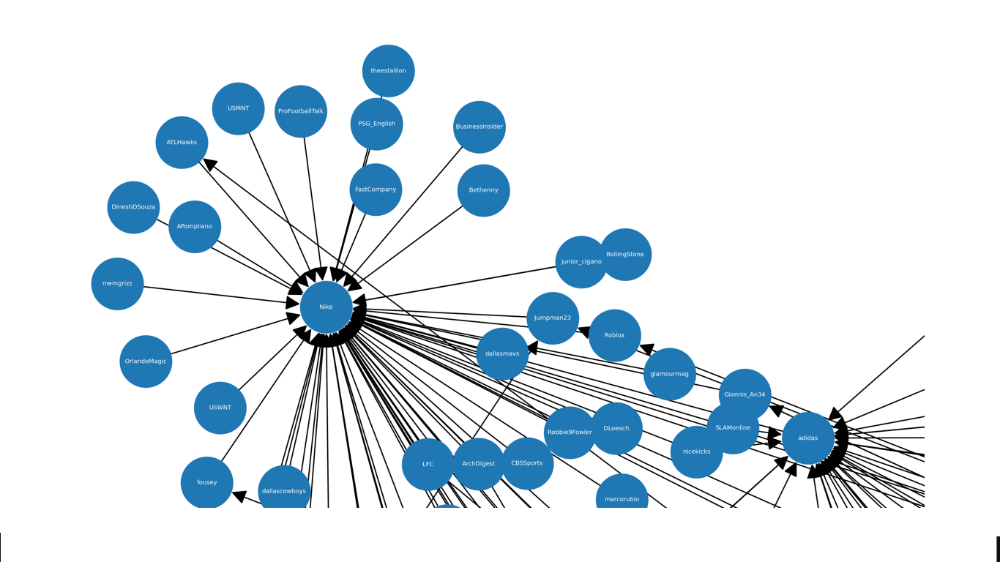

In [ ]:
#from google.colab import files
#from IPython.display import Image
uploaded = files.upload()
Image('nikesocial.png')


Saving adidassocial.png to adidassocial.png


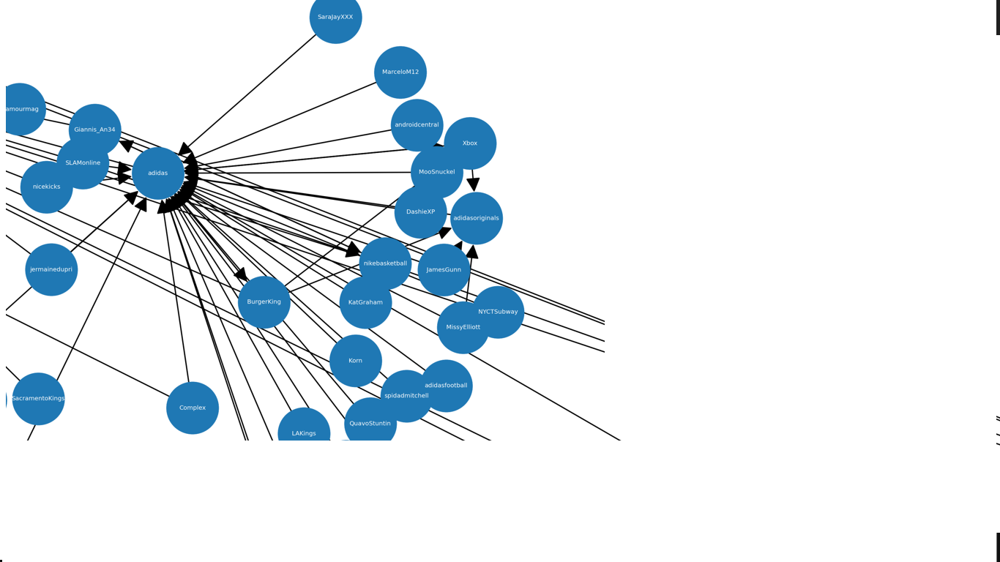

In [ ]:
uploaded = files.upload()
Image('adidassocial.png')

Saving lulusocial.png to lulusocial.png


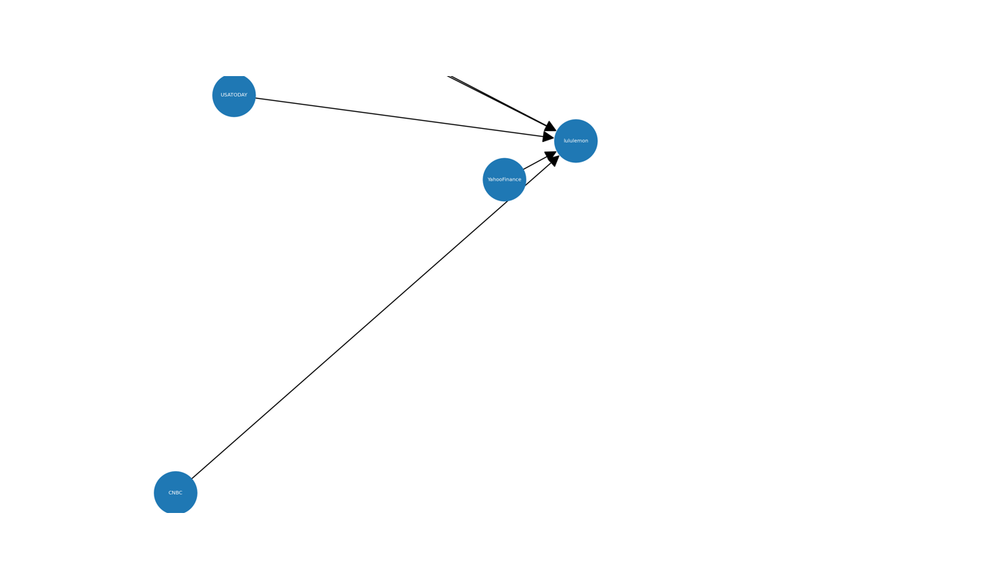

In [ ]:
uploaded = files.upload()
Image('lulusocial.png')

# Social Network Insights

The brand central users are those the accounts of the nodes represented nearby to the brands on the visualizations and are highly connected to the brands. 

For Nike, accounts associated with sports are most central. Some found nearby in both networks were "LFC" (Liverpool Football Club), "USMNT", "USWNT", (United States men's and women's soccer teams) "dallascowboys" and "jumpman23" (Michael Jordan). There are also some celebrity accounts (Taraji P. Henson's and Megan Thee Stallion's) as well as "BusinessInsider". It is likely the sports teams are sponsored by Nike. 

For Adidas, there is some connection with sports such as with Brazilian football player Marcelo's account and a few NBA teams (Sacramento Kings, LA Kings, Brooklyn Nets and Detroit Pistons). There are more corporations such as Xbox, Burger King and Android who maybe strategic partners. Complex, which is a media company associated with youth culture is also very centrally located.

Lululemon is mentioned by traditional media companies (CNBC, USA Today)  rather than accounts associated with sports, celebrities or culture. 

Bridgers in the network are accounts represented by nodes that connect the brand nodes and represent those that have strong overall influence in the collective space of the brands.

A bridger account that connects all three twitter accounts is "wwd" which is a media company that focuses on fashion, beauty and business. Complex also connects Nike and Adidas (who are also directly connected) via Tinashe's account. 

# Text Preprocessing

For the semantic networks, text preprocessing of the tweets are needed and the following code blocks are used to this end in order to extract meaningful descriptive words about the brands. They are presented in the order preprocessing of the tweet text is done.

In [ ]:
TWEET_TOKENIZER = nltk.TweetTokenizer().tokenize
WORD_TOKENIZER = nltk.tokenize.word_tokenize

def tokenize(text, lowercase=True, tweet=False):
    """Tokenize the text. By default, also normalizes text to lowercase.
    Optionally uses the Tweet Tokenizer.
    """
    if lowercase:
        text = text.lower()
    if tweet:
        return TWEET_TOKENIZER(text)
    else:
        return WORD_TOKENIZER(text)

In [ ]:
def remove_links(tokens):
    """Removes http/s links from the tokens.

    This simple implementation assumes links have been kept intact as whole
    tokens. E.g. the way the Tweet Tokenizer works.
    """
    return [ t for t in tokens
            if not t.startswith("http://")
            and not t.startswith("https://")
        ]

In [ ]:
def remove_stopwords(tokens, stopwords=None):
    """Remove stopwords, i.e. words that we don't want as part of our
    analysis. Defaults to the default set of nltk english stopwords.
    """
    if stopwords is None:
        stopwords = nltk.corpus.stopwords.words("english")
    return [ token for token in tokens if token not in stopwords ]

In [ ]:
def remove_punctuation(tokens,
                       strip_mentions=False,
                       strip_hashtags=False,
                       strict=False):
    """Remove punctuation from a list of tokens.

    Has some specialized options for dealing with Tweets:

    strip_mentions=True will strip the @ off of @ mentions
    strip_hashtags=True will strip the # from hashtags

    strict=True will remove all punctuation from all tokens, not merely
    just tokens that are punctuation per se. 
    """
    tokens = [t for t in tokens if t not in string.punctuation]
    if strip_mentions:
        tokens = [t.lstrip('@') for t in tokens]
    if strip_hashtags:
        tokens = [t.lstrip('#') for t in tokens]
    if strict:
        cleaned = []
        for t in tokens:
            cleaned.append(
                t.translate(str.maketrans('', '', string.punctuation)).strip())
        tokens = [t for t in cleaned if t]
    return tokens

In [ ]:
LEMMATIZER = nltk.WordNetLemmatizer()

def lemmatize(tokens):
    """Lemmatize the tokens.
    
    Retains more natural word forms than stemming, but assumes all
    tokens are nouns unless tokens are passed as (word, pos) tuples.
    """
    lemmas = []
    for token in tokens:
        if isinstance(token, str):
            lemmas.append(LEMMATIZER.lemmatize(token)) # treats token like a noun
        else: # assume a tuple of (word, pos)
            lemmas.append(LEMMATIZER.lemmatize(*token))
    return lemmas

The following function with the length variable set to 2 to ensure that only tokens of length 3 or more will be considered. This will remove words without much value from our analysis.

In [ ]:
def removesmallwords(tokenizedtext, length):
  goodwords = []
  for a_feature in tokenizedtext:
    if len(a_feature) > length:
      goodwords.append(a_feature)
  return goodwords

The tweets sent by only the 50 identified influencers from the social network are utilized. This will result in a smaller number of tweets being considered with the trade-off that the impact of each tweet is greater and the and the co-occurrences of words in these tweets are of greater significance.

In [ ]:
json_file = open('%s/nikelululemonadidas_tweets.jsonl' % WORKING_DIR, 'r')

In [ ]:
word_counts = {}

for i, line in enumerate(json_file):
  if i % 10000 == 0:
    print("%s tweets processed" % i)
  tweet = json.loads(line)
  sender_name = tweet["user"]["screen_name"]
  if sender_name in userstoinclude: # Influencers previously determined.
    text = tweet["full_text"]
    tokens = tokenize(text, tweet=True)
    tokens = remove_links(tokens)
    tokens = remove_stopwords(tokens)
    tokens = remove_punctuation(tokens, strip_mentions=True, strip_hashtags=True)
    tokens = lemmatize(tokens) 
    tokens = removesmallwords(tokens, 2)
    for word in tokens:
      if word not in word_counts:
        word_counts[word] = 0
      word_counts[word] += 1

print(f"{i} total Tweets processed")

0 tweets processed
10000 tweets processed
20000 tweets processed
30000 tweets processed
40000 tweets processed
50000 tweets processed
60000 tweets processed
70000 tweets processed
80000 tweets processed
90000 tweets processed
100000 tweets processed
110000 tweets processed
120000 tweets processed
130000 tweets processed
140000 tweets processed
150000 tweets processed
160000 tweets processed
170000 tweets processed
175077 total Tweets processed


In [ ]:
len(word_counts)

646

In [ ]:
sorted_counts = sorted(word_counts.items(), key=lambda item: item[1], reverse=True)
sorted_words = [word for word, count in sorted_counts]

In [ ]:
sorted_words[:50]

['nike',
 'adidas',
 'xbox',
 'new',
 'lebron',
 'james',
 'sport',
 'innovation',
 'center',
 'metaverse',
 'get',
 'company',
 'look',
 '20th',
 'forum',
 'tech',
 'day',
 'report',
 'shoe',
 'eneskanter',
 'like',
 'higher',
 'basketball',
 'exclusive',
 'went',
 'xbox20',
 'inside',
 'launch',
 'boost',
 'read',
 'congrats',
 'game',
 'follow',
 'including',
 'rule',
 'got',
 'kasnov3kane24',
 'started',
 'love',
 'together',
 'stop',
 'pair',
 'say',
 'complexstyle',
 'roblox',
 'nikeland',
 'link',
 'watch',
 'lululemon',
 'holiday']

The words are relatively meaningful with "Nike" and "adidas" at the top and "lululemon" in the top 50. 

In [ ]:
print("Nike:", word_counts["nike"])
print("Adidas:", word_counts["adidas"])
print("Lululemon:", word_counts["lululemon"])

Nike: 49
Adidas: 31
Lululemon: 3


 
The use of influencers with very stringent criteria results in relatively low word counts. However there are additional trade-offs for this. For the word counts to be larger, the number of tweets is also larger resulting in a higher likelihood of co-occurrences between words. This can often result in a nearly complete graph. As our graph construction is unweighted with an edge based only on a single co-occurrence, a nearly complete graph will be drawn with nodes placed based on which words do not co-occur. This gives rise to unnatural visual word clusters and doesn't capture the associations one would like from the data.


# Semantic Network, 50 Influencers & 50 Words

 As co-occurrences of words in text are a symmetric relationship, in order to construct edges in the semantic network an undirected graph is appropriate. 


In [ ]:
graph = nx.Graph()

In [ ]:
json_file = open('%s/nikelululemonadidas_tweets.jsonl' % WORKING_DIR, 'r')

The top 50 words are used by word count, which captures Lululemon.

In [ ]:
N = 50
top_terms = sorted_words[:N]

for i, line in enumerate(json_file):
  if i % 10000 == 0:
    print("%s tweets processed" % i)
  tweet = json.loads(line)
  sender_name = tweet["user"]["screen_name"]
  if sender_name in userstoinclude:
    text = tweet["full_text"]
    tokens = tokenize(text, tweet=True)
    tokens = remove_links(tokens)
    tokens = remove_stopwords(tokens)
    tokens = remove_punctuation(tokens, strip_mentions=True, strip_hashtags=True)
    tokens = lemmatize(tokens) 
    tokens = removesmallwords(tokens, 2)

    nodes = [t for t in tokens if t in top_terms]
    cooccurrences = itertools.combinations(nodes, 2)
    graph.add_edges_from(cooccurrences)


0 tweets processed
10000 tweets processed
20000 tweets processed
30000 tweets processed
40000 tweets processed
50000 tweets processed
60000 tweets processed
70000 tweets processed
80000 tweets processed
90000 tweets processed
100000 tweets processed
110000 tweets processed
120000 tweets processed
130000 tweets processed
140000 tweets processed
150000 tweets processed
160000 tweets processed
170000 tweets processed


In [ ]:
nx.info(graph)

'Graph with 50 nodes and 251 edges'

In [ ]:
graph.remove_edges_from(nx.selfloop_edges(graph))
nx.info(graph)

'Graph with 50 nodes and 244 edges'

Note that this is less than 5 edges per node so the graph is far from complete.

In [ ]:
random.seed(0) # for reproducibility
np.random.seed(0) # for reproducibility
fig, ax = plt.subplots(1, 1, figsize=(200, 200))
#ugh these settings are such a pain, but here's the way to look them up: 
#https://networkx.org/documentation/stable/reference/generated/networkx.drawing.nx_pylab.draw_networkx.html
nx.draw_networkx(graph, ax=ax, font_color="#FFFFFF", font_size=20, node_size=30000, width=4, arrowsize=100)
plt.savefig("%s/semantic_network.png" % WORKING_DIR, format="PNG")

In [ ]:
graph.edges

EdgeView([('like', 'higher'), ('like', 'basketball'), ('like', 'exclusive'), ('like', 'new'), ('like', 'lebron'), ('like', 'james'), ('like', 'innovation'), ('like', 'center'), ('like', 'nike'), ('like', 'company'), ('like', 'sport'), ('higher', 'basketball'), ('higher', 'exclusive'), ('higher', 'new'), ('higher', 'lebron'), ('higher', 'james'), ('higher', 'innovation'), ('higher', 'center'), ('higher', 'nike'), ('basketball', 'exclusive'), ('basketball', 'new'), ('basketball', 'lebron'), ('basketball', 'james'), ('basketball', 'innovation'), ('basketball', 'center'), ('basketball', 'nike'), ('basketball', 'sport'), ('basketball', 'shoe'), ('exclusive', 'new'), ('exclusive', 'lebron'), ('exclusive', 'james'), ('exclusive', 'innovation'), ('exclusive', 'center'), ('exclusive', 'nike'), ('exclusive', 'adidas'), ('exclusive', 'xbox'), ('exclusive', 'follow'), ('exclusive', 'including'), ('exclusive', '20th'), ('exclusive', 'forum'), ('exclusive', 'tech'), ('exclusive', 'shoe'), ('exclusiv

In [ ]:
brand_counts = {}
brand_counts['lululemon'] = 0 
brand_counts['nike'] = 0
brand_counts['adidas'] = 0

for edge in graph.edges:
 for node in edge:
   if node in brand_counts:
     brand_counts[node] += 1

brand_counts

{'adidas': 28, 'lululemon': 2, 'nike': 39}

Nike is connected to 39 out of 49 of the other nodes and Adidas is also connected to more than half at 28.

# Semantic Network, 50 Influencers, All Words (600 +)




 
The process is repeated using all words and not the top 50 which results in visual world clusters that can be interpreted as words associated with one another based on the data set. 


In [ ]:
graph = nx.Graph()

In [ ]:
json_file = open('%s/nikelululemonadidas_tweets.jsonl' % WORKING_DIR, 'r')

In [ ]:
top_terms = sorted_words

for i, line in enumerate(json_file):
  if i % 10000 == 0:
    print("%s tweets processed" % i)
  tweet = json.loads(line)
  sender_name = tweet["user"]["screen_name"]
  if sender_name in userstoinclude:
    text = tweet["full_text"]
    tokens = tokenize(text, tweet=True)
    tokens = remove_links(tokens)
    tokens = remove_stopwords(tokens)
    tokens = remove_punctuation(tokens, strip_mentions=True, strip_hashtags=True)
    tokens = lemmatize(tokens) 
    tokens = removesmallwords(tokens, 2)

    nodes = [t for t in tokens if t in top_terms]
    cooccurrences = itertools.combinations(nodes, 2)
    graph.add_edges_from(cooccurrences)


0 tweets processed
10000 tweets processed
20000 tweets processed
30000 tweets processed
40000 tweets processed
50000 tweets processed
60000 tweets processed
70000 tweets processed
80000 tweets processed
90000 tweets processed
100000 tweets processed
110000 tweets processed
120000 tweets processed
130000 tweets processed
140000 tweets processed
150000 tweets processed
160000 tweets processed
170000 tweets processed


In [ ]:
nx.info(graph)

'Graph with 645 nodes and 5284 edges'

In [ ]:
graph.remove_edges_from(nx.selfloop_edges(graph))
nx.info(graph)

'Graph with 645 nodes and 5272 edges'

Again the graph is far from complete with under 10 edges per node.

The below image needs to be downlaoded for viewing.

In [ ]:
random.seed(0) # for reproducibility
np.random.seed(0) # for reproducibility
fig, ax = plt.subplots(1, 1, figsize=(300, 300))
#ugh these settings are such a pain, but here's the way to look them up: 
#https://networkx.org/documentation/stable/reference/generated/networkx.drawing.nx_pylab.draw_networkx.html
nx.draw_networkx(graph, ax=ax, font_color="#FFFFFF", font_size=20, node_size=30000, width=4, arrowsize=100)
plt.savefig("%s/semantic_network2.png" % WORKING_DIR, format="PNG")

/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 120294 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 120316 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 120314 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:214: RuntimeWarning: Glyph 120306 missing from current font.
  font.set_text(s, 0.0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 120294 missing from current font.
  font.set_text(s, 0, flags=flags)
/usr/local/lib/python3.7/dist-packages/matplotlib/backends/backend_agg.py:183: RuntimeWarning: Glyph 120316 missing from current font.
  font.

In [ ]:
brand_counts = {}
brand_counts['lululemon'] = 0 
brand_counts['nike'] = 0
brand_counts['adidas'] = 0

for edge in graph.edges:
 for node in edge:
   if node in brand_counts:
     brand_counts[node] += 1

brand_counts

{'adidas': 228, 'lululemon': 25, 'nike': 351}

Saving wordclust.png to wordclust.png


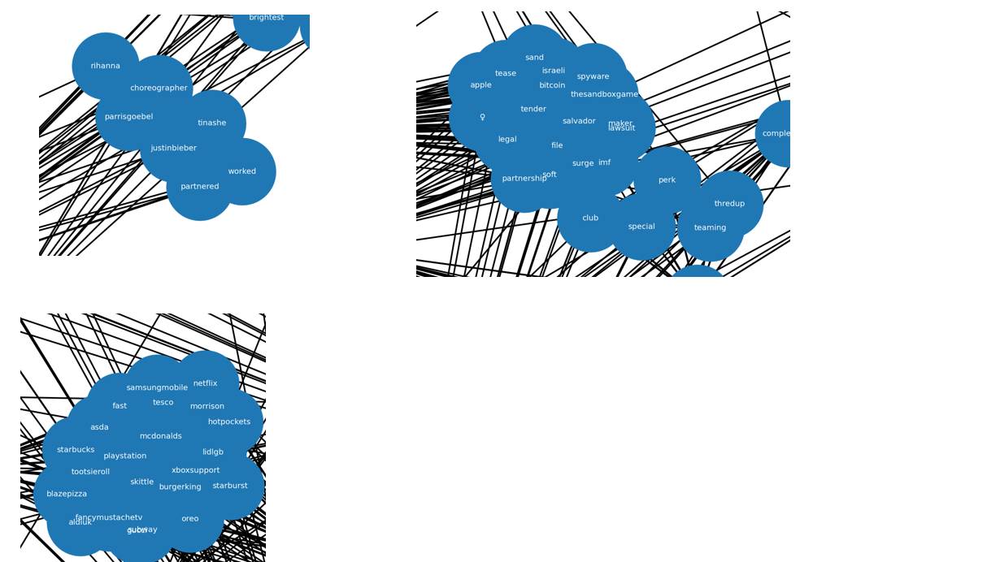

In [ ]:
#uploaded = files.upload()
#Image('wordclust.png')

Saving wordclustbrand.png to wordclustbrand.png


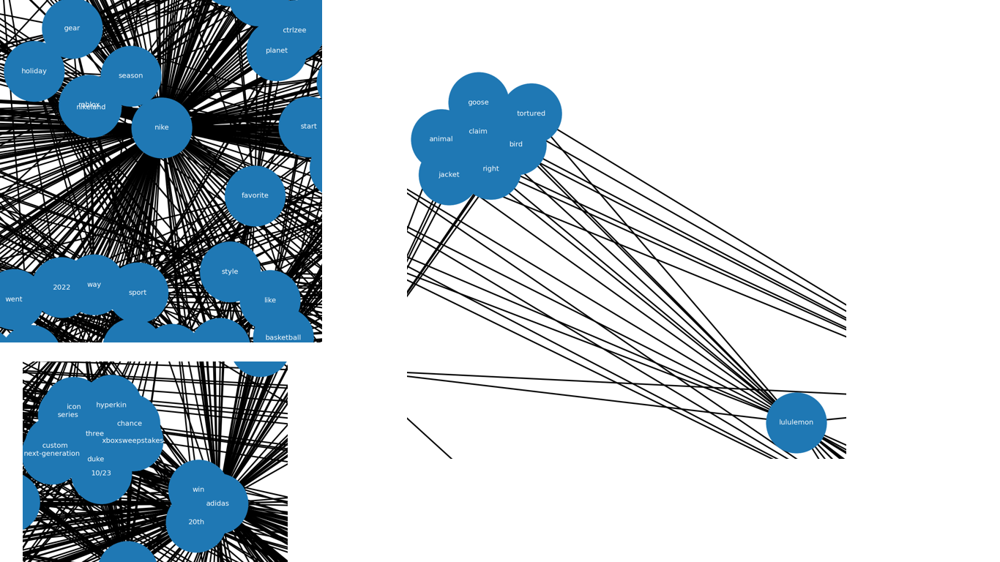

In [ ]:
#uploaded = files.upload()
#Image('wordclustbrand.png')

# Semantic Network Insights

Nike is conncted uniquely to "lebron" and "basketball" in the smaller semantic network and those words are central to Nike's brand.

"Holiday" is connected to all three brands as a bridging word in even the smaller semantic network. Expected words such as "shoe", "exclusive", "sport" and "new" are words connected in near proximity to Nike and Adidas in this network too. 

The larger network even with words with the small word counts created numerous related word clusters including one for musical performers (Bieber, Rihanna and Tinashe), one relating to electronic payments (Apple, Bitcoin, file, spyware) and one for large corporations (Netflix, McDonalds, Samsung, Playstation etc.) 

Nike is associated in the larger semantic network with sport, adventure and style. Adidas' social network relationship with Xbox persists in the semantic network. Adidas may wish to adjust their branding to cut into Nike's ties to their word cluster. The cluster closest to Lululemon seemed to suggest ethical concerns about using geese in their jackets but this may all come from a sole tweet due to the low word count.
 
Bridging words are harder to discern in the larger network due to the large number of edges and deferring to the analysis in the smaller network seems appropriate. 

# Summary

Comparatively the social network analysis is probably more robust due to the low word counts in the semantic network, even though meaningful clusters were formed. Recall the semantic network requires a vastly condensed tweet set in order to avoid fully connected graphs driven by likely co-occurrences. At least here even if the word counts were small, the impact per word count was large due to each tweet being from an account with over 2 million followers.
 
One improvement to the current workflow would be to consider a weighted graph that considers the number of co-occurrences that occur in the tweet to minimize the issues with near fully connected semantic network graphs. Networkx can factor in the edge weights and the visual clustering more closely captures the associations between words in tweets we hope to uncover.
